# Building Music Recommendation System using Spotify Dataset

## Import Libraries

In [3]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

## Read Data

In [5]:
data = pd.read_csv("./data/data.csv")
genre_data = pd.read_csv('./data/data_by_genres.csv')
year_data = pd.read_csv('./data/data_by_year.csv')

In [6]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [7]:
print(genre_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


In [8]:
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


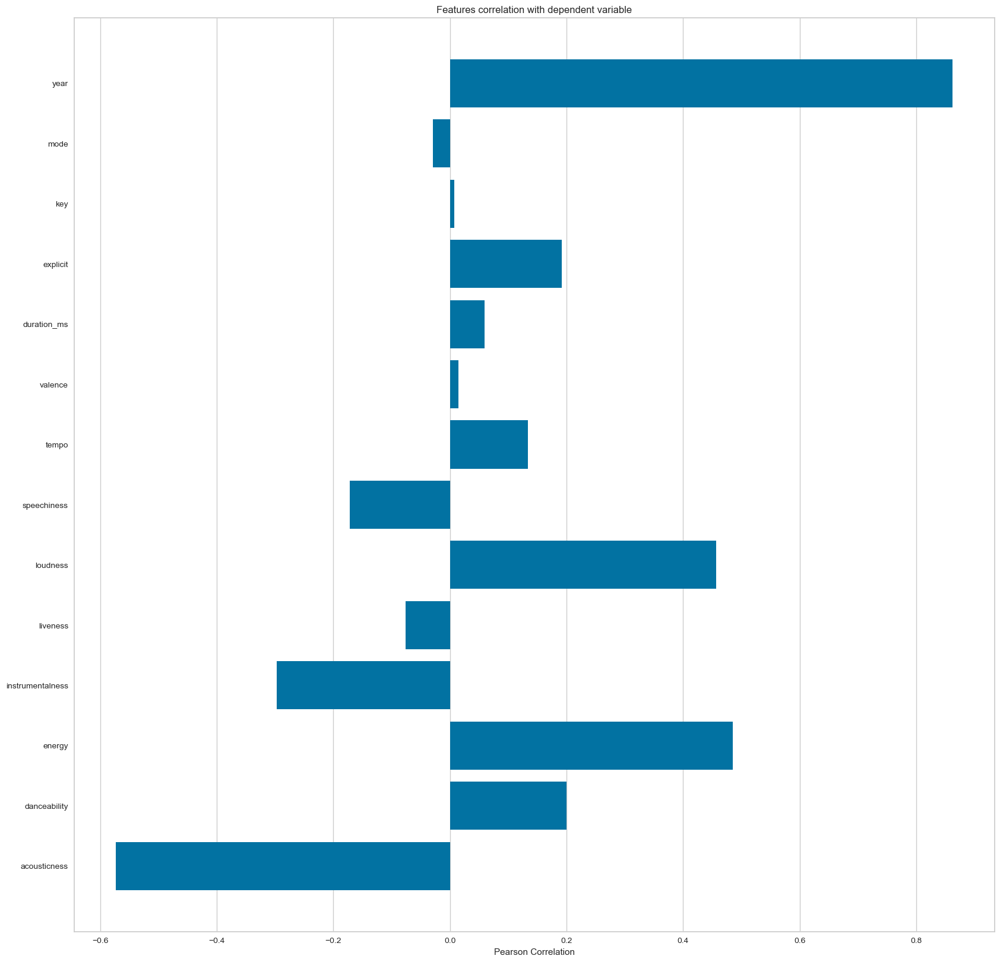

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [9]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

## Data Understanding by Visualization and EDA

## Music Over Time

 - Using the data grouped by year, we can understand how the overall sound of music has changed from 1921 to 2020.

<Axes: xlabel='count', ylabel='decade'>

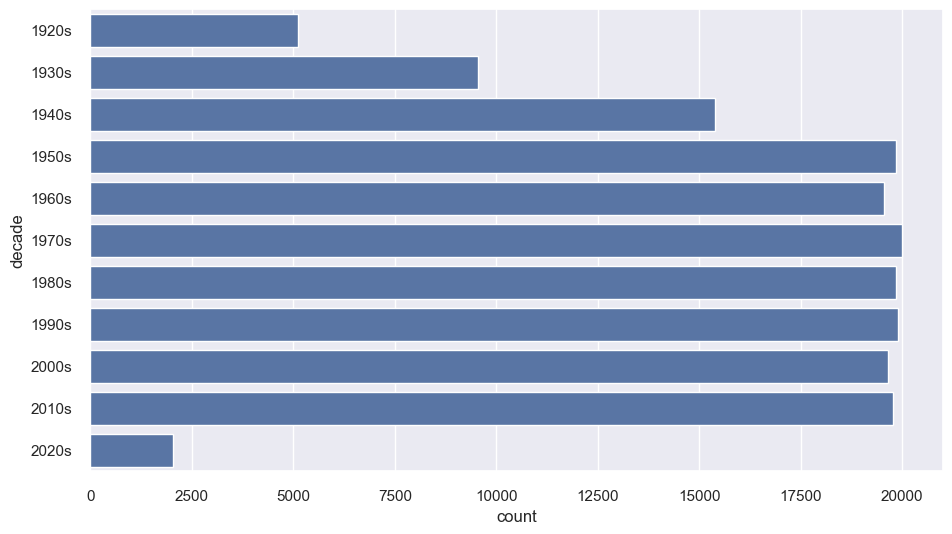

In [12]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(data['decade'])

In [13]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

## Characteristics of Different Genres
 - This dataset contains the audio features for different songs along with the audio features for different genres. We can use this information to compare different genres and understand their unique differences in sound.

In [15]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

## Clustering Genres with K-Means

In [17]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [18]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.008s...
[t-SNE] Computed neighbors for 2973 samples in 0.341s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106003
[t-SNE] KL divergence after 1000 iterations: 1.392018


## Clustering Songs with K-Means

In [20]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [21]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

## Build Recommender System
 - Based on the analysis and visualizations, it’s clear that similar genres tend to have data points that are located close to each other while similar types of songs are also clustered together.
 - This observation makes perfect sense. Similar genres will sound similar and will come from similar time periods while the same can be said for songs within those genres. We can use this idea to build a recommendation system by taking the data points of the songs a user has listened to and recommending songs corresponding to nearby data points.
 - Spotipy is a Python client for the Spotify Web API that makes it easy for developers to fetch data and query Spotify’s catalog for songs. You have to install using pip install spotipy
 - After installing Spotipy, you will need to create an app on the Spotify Developer’s page and save your Client ID and secret key.

In [23]:
os.environ["SPOTIFY_CLIENT_ID"] = "ab993259c7794e498189503a0c026eab"
os.environ["SPOTIFY_CLIENT_SECRET"] = "bb5649bcf5394f36abbe49e618c82f8b"

In [24]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=os.environ["SPOTIFY_CLIENT_ID"],
                                                           client_secret=os.environ["SPOTIFY_CLIENT_SECRET"]))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [25]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song_name, spotify_data):
    """
    Retrieves song data based on song name, using fuzzy matching if necessary.
    """
    # Attempt to find an exact match
    matches = spotify_data[spotify_data['name'] == song_name]
    if not matches.empty:
        return matches.iloc[0]

    # If no exact match, try fuzzy matching
    closest_match = difflib.get_close_matches(song_name, spotify_data['name'], n=1, cutoff=0.6)
    if closest_match:
        matched_song = spotify_data[spotify_data['name'] == closest_match[0]].iloc[0]
        print(f"Using '{closest_match[0]}' as the closest match for '{song_name}'")
        return matched_song

    print(f"Warning: Song '{song_name}' not found in the database.")
    return None
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        # Ensure song_vector has the expected number of features
        song_vector = song_data[number_cols].values
        if len(song_vector) != len(number_cols):
            print(f"Warning: Song {song['name']} has missing features. Skipping.")
            continue  # Skip songs with missing features
        song_vectors.append(song_vector)  
    
    # Check if any song vectors were collected
    if not song_vectors:
        print("Error: No valid song vectors found.")
        return None  # Or raise an exception if preferred

    song_matrix = np.array(song_vectors)  
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs(song_name, spotify_data, n_songs=5):
    """
    Recommends songs based on a given song name.
    """
    song_data = get_song_data(song_name, spotify_data)
    if song_data is None:
        print(f"Error: Could not find data for '{song_name}'.")
        return []

    song_vector = song_data[number_cols].values
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_vector = scaler.transform(song_vector.reshape(1, -1))
    distances = cdist(scaled_song_vector, scaled_data, 'cosine')

    index = list(np.argsort(distances)[:, :n_songs][0])
    rec_songs = spotify_data.iloc[index]

    # Exclude the input song from recommendations
    rec_songs = rec_songs[rec_songs['name'] != song_name]
    return rec_songs[['name','year']]

In [26]:
recommend_songs("main agar kahoon",data)

Using 'Main Agar Kahoon' as the closest match for 'main agar kahoon'


,name,year
153082,Main Agar Kahoon,2007
105972,SAKURA,2006
54820,RoboCop,2008
169609,Nothing Left (feat. Will Heard),2015
87597,The Other Song,1997


## Making connection with backend

In [ ]:
from flask import Flask, request, jsonify
from flask_cors import CORS
app = Flask(__name__)
CORS(app)

@app.route('/recommend', methods=['GET'])
def recommend():
    song_name = request.args.get('song')
    recommendations = recommend_songs(song_name, data)  
    print(recommendations.to_dict(orient='records'))
    return jsonify({"recommendations": recommendations.to_dict(orient='records')})

if __name__ == '__main__':
    app.run(port=5000)


 * Serving Flask app '__main__'
 * Debug mode: off


 * Running on http://127.0.0.1:5000
Press CTRL+C to quit
127.0.0.1 - - [15/Nov/2024 15:55:45] "GET /recommend?song=mai%20agar%20kahoon HTTP/1.1" 200 -


Using 'Main Agar Kahoon' as the closest match for 'mai agar kahoon'
[{'name': 'Main Agar Kahoon', 'year': 2007}, {'name': 'SAKURA', 'year': 2006}, {'name': 'RoboCop', 'year': 2008}, {'name': 'Nothing Left (feat. Will Heard)', 'year': 2015}, {'name': 'The Other Song', 'year': 1997}]


127.0.0.1 - - [15/Nov/2024 15:59:15] "GET /recommend?song=mai%20agar%20kahoon HTTP/1.1" 200 -


Using 'Main Agar Kahoon' as the closest match for 'mai agar kahoon'
[{'name': 'Main Agar Kahoon', 'year': 2007}, {'name': 'SAKURA', 'year': 2006}, {'name': 'RoboCop', 'year': 2008}, {'name': 'Nothing Left (feat. Will Heard)', 'year': 2015}, {'name': 'The Other Song', 'year': 1997}]


127.0.0.1 - - [15/Nov/2024 15:59:49] "GET /recommend?song=Mai%20hu%20na HTTP/1.1" 200 -


Using 'Marina' as the closest match for 'Mai hu na'
[{'name': 'Marina', 'year': 1942}, {'name': 'Ek Bholi Bhali Gori Ne', 'year': 1948}, {'name': 'Alta Payer Alto Chhonwa Porechhe', 'year': 1952}, {'name': 'Rosiniolita', 'year': 1935}, {'name': 'Rosiniolita', 'year': 1935}]


127.0.0.1 - - [15/Nov/2024 16:00:32] "GET /recommend?song=Aa%20ab%20launt%20chale HTTP/1.1" 200 -


Using 'Aa Ab Laut Chalen' as the closest match for 'Aa ab launt chale'
[{'name': 'Aa Ab Laut Chalen', 'year': 1960}, {'name': 'Duniya Bananewale', 'year': 1966}, {'name': 'Jo Dil Men Basai Thi', 'year': 1944}, {'name': 'Ta kommena ta mallia soy', 'year': 1939}, {'name': "Mame: It's Today", 'year': 1966}]


127.0.0.1 - - [15/Nov/2024 16:00:52] "GET /recommend?song=Khairiyat HTTP/1.1" 200 -


Using 'Karate' as the closest match for 'Khairiyat'
[{'name': 'Karate', 'year': 1963}, {'name': 'The Playground', 'year': 1966}, {'name': 'New Math', 'year': 1965}, {'name': 'Casey At The Bat - Live', 'year': 1954}, {'name': 'Oedipus Rex', 'year': 1959}]


127.0.0.1 - - [15/Nov/2024 16:02:00] "GET /recommend?song=I%20love%20you HTTP/1.1" 200 -


Using 'i love you' as the closest match for 'I love you'
[{'name': 'i love you', 'year': 2019}, {'name': 'Morning Sun', 'year': 2015}, {'name': 'Cover Me Up', 'year': 2013}, {'name': 'White Blood', 'year': 2015}, {'name': 'Arms', 'year': 2018}]


127.0.0.1 - - [15/Nov/2024 16:02:16] "GET /recommend?song=it's%20like%20you HTTP/1.1" 200 -


Using 'i love you' as the closest match for 'it's like you'
[{'name': 'i love you', 'year': 2019}, {'name': 'Morning Sun', 'year': 2015}, {'name': 'Cover Me Up', 'year': 2013}, {'name': 'White Blood', 'year': 2015}, {'name': 'Arms', 'year': 2018}]


127.0.0.1 - - [15/Nov/2024 16:02:37] "GET /recommend?song=the%20sun HTTP/1.1" 200 -


Using 'The Sun' as the closest match for 'the sun'
[{'name': 'The Sun', 'year': 2002}, {'name': 'The Sun', 'year': 2002}, {'name': 'Over It', 'year': 2007}, {'name': 'Man on the Moon', 'year': 2016}, {'name': 'Take It on the Run', 'year': 1988}]


127.0.0.1 - - [15/Nov/2024 16:05:22] "GET /recommend?song=Khushboo HTTP/1.1" 200 -


Using 'Mushaboom' as the closest match for 'Khushboo'
[{'name': 'Mushaboom', 'year': 2004}, {'name': 'Cumbia De Los Estados', 'year': 2000}, {'name': 'Falsa Traición', 'year': 1993}, {'name': 'Me Gusta Tener De A Dos', 'year': 2000}, {'name': 'Veinticinco Rosas', 'year': 1997}]


127.0.0.1 - - [15/Nov/2024 16:05:44] "GET /recommend?song=Chetan HTTP/1.1" 200 -


Using 'Cheetah' as the closest match for 'Chetan'
[{'name': 'Cheetah', 'year': 1966}, {'name': 'Mild Is The Mood', 'year': 1960}, {'name': 'Gaza Strip', 'year': 1957}, {'name': 'Savoir Faire - 2018 Remaster', 'year': 1978}, {'name': 'Double-O', 'year': 1958}]
